In [1]:
# ML Assignment3: 
# https://github.com/visualizedata/ml/blob/master/final_assignment_3/option_2/cluster_starter.ipynb
# Code from Aaron Hill

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [2]:
fpn_csv = '/Users/yichanwang/Dropbox/2020Fall_Parsons/MachineLearning/Assignment3/cluster_images.csv'
data = pd.read_csv(fpn_csv, encoding='ISO-8859-1')

In [3]:
# get column names
list(data)

['s_no',
 'artist',
 'title',
 'art_movement',
 'museum_venue',
 'country_of_origin',
 'has_text',
 'primary_medium',
 'medium',
 'work_size',
 'date',
 'representation',
 'representation_semi',
 'kinetic',
 'map',
 'map2',
 'spatial_dimension',
 'spatial_dimension2',
 'pl',
 'si',
 'va',
 'te',
 'co',
 'or',
 'sh',
 'reflection',
 'po',
 'li',
 'ar',
 'notes']

In [4]:
data.head()

,s_no,artist,title,art_movement,museum_venue,country_of_origin,has_text,primary_medium,medium,work_size,...,va,te,co,or,sh,reflection,po,li,ar,notes
0,2,Giorgio de Chirico,The Uncertainty of the Poet,surrealism,Tate,Italy,False,painting,"painting, oil on canvas",106 x 94 cm,...,3,0,0,4,3,False,0,0,5,"distorted perspective, shadow, signification o..."
1,3,Giovanni Anselmo,Direction,arte povera,Tate,Italy,False,sculpture,"sculpture, fabric, glass & metal",24 x 420 x 335 cm,...,1,3,0,3,2,False,0,0,5,"hard to understand the viewpoint, sense of for..."
2,4,Milton Avery,Yellow Sky,modernism,Tate,America,False,painting,"painting, oil on canvas",156 x 184 cm,...,2,4,4,2,4,False,0,0,5,"flatish, textured shapes & specific colors-lin..."
3,5,Gillian Avery,Distillation,abstraction,Tate,UK,False,painting,"painting, oil, household paint on hardboard",213 x 152 cm,...,1,2,0,2,4,False,0,0,5,"shapes, layers, paint handlng/texture, orienta..."
4,6,Joseph (Jef) Banc,Pair-Bearing Matrix,abstraction,Tate,France,False,painting,"painting, mixed media on canvas",73 x 60 cm,...,1,4,1,0,4,False,0,0,5,"ambiguity through abstraction, odd shape, v te..."


In [65]:
## replace missing values with 0
data['representation'] = data['representation'].replace(np.nan, 0)
data['primary_medium'] = data['primary_medium'].replace(np.nan, 0)
data['art_movement'] = data['art_movement'].replace(np.nan, 0)

## transform primary medium and art movement into numerical keys
art_movement_list = data['art_movement'].to_list()
primary_medium_list = data['primary_medium'].to_list()

movement_list = list()
medium_list = list()

for item in art_movement_list:
    if item not in movement_list:
        movement_list.append(item)

for item in primary_medium_list:
    if item not in medium_list:
        medium_list.append(item)
        
rows = data.shape[0]

for i in range(0, rows ):
    movement = data['art_movement'].values[i]
    medium = data['primary_medium'].values[i]
    movement_index = movement_list.index(movement)
    medium_index = medium_list.index(medium)
    data['art_movement'].values[i] = movement_index
    data['primary_medium'].values[i] = medium_index
    

X = data[['art_movement', 'primary_medium', 'representation', 'te', 'sh', 'li']]

In [66]:
X.head()

,art_movement,primary_medium,representation,te,sh,li
0,0,0,1.0,0,3,0
1,1,1,1.0,3,2,0
2,2,0,1.0,4,4,0
3,3,0,0.0,2,4,0
4,3,0,0.0,4,4,0


In [67]:
from sklearn.cluster import KMeans

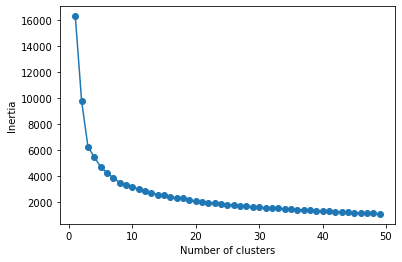

In [68]:
# container to store inertia scores over iterations
distortions = []

# fit KMeans iteratively to begin to assess the appropriate number of clusters
for i in range(1, 50):
    km = KMeans(n_clusters=i)
    km.fit(X)
    distortions.append(km.inertia_)
    
# vizualize change in inertia
plt.plot(range(1, 50), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

In [82]:
# modify this list to include the numbers of clusters you want to see
range_n_clusters = [10, 14, 18, 24, 32, 36, 42]

For n_clusters = 10 The average silhouette_score is : 0.2585586514835436


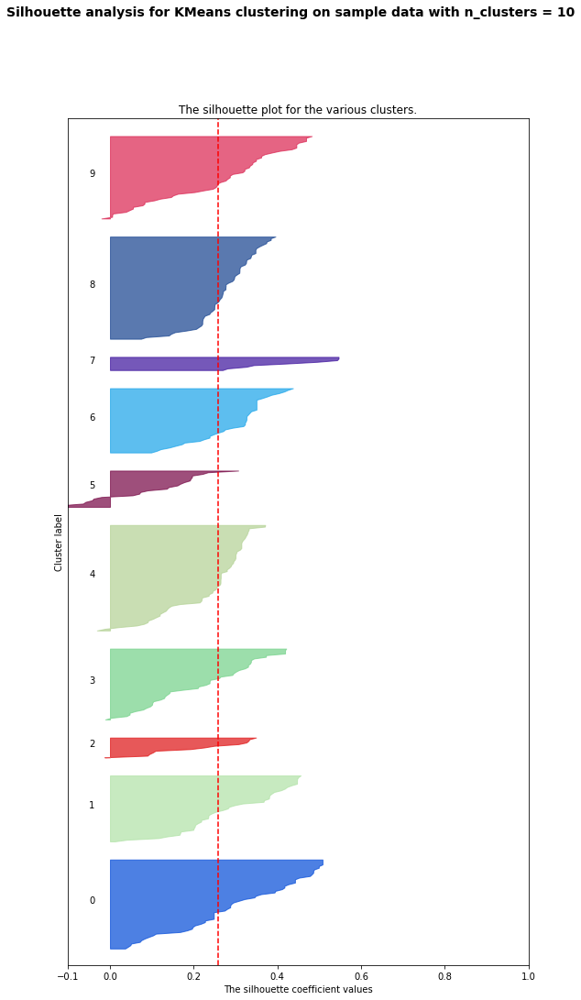

For n_clusters = 14 The average silhouette_score is : 0.2571225965608286


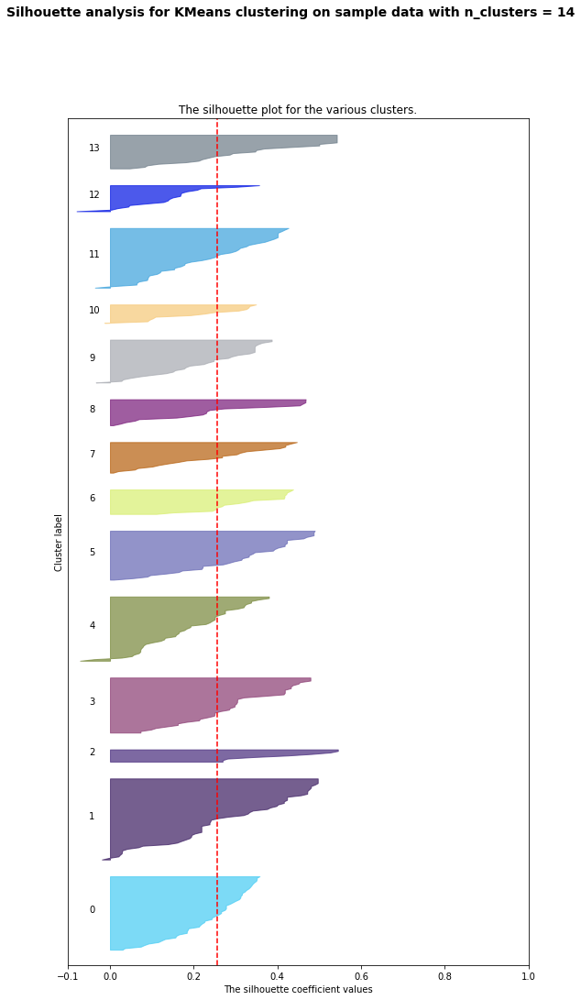

For n_clusters = 18 The average silhouette_score is : 0.25417256357608675


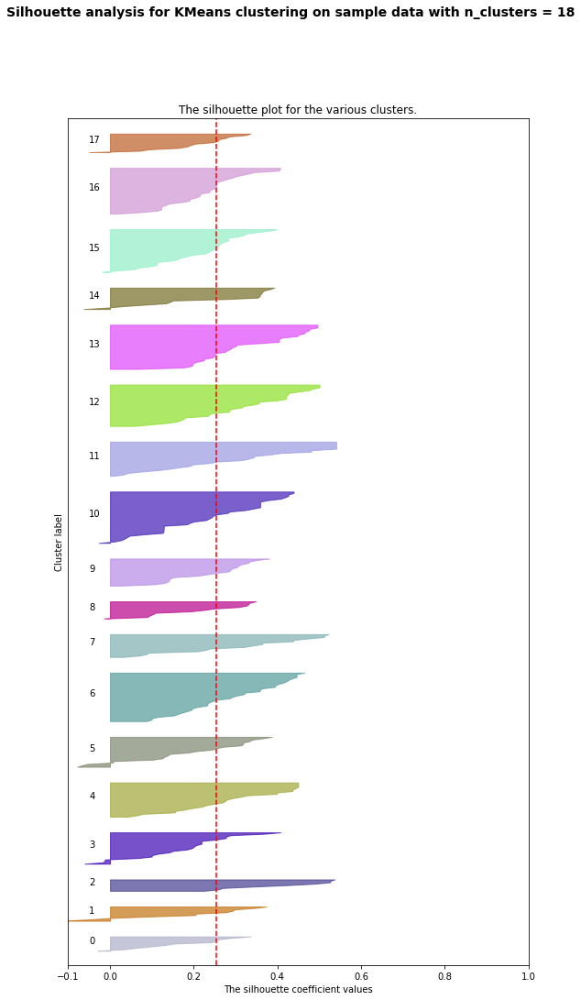

For n_clusters = 24 The average silhouette_score is : 0.2594588000653035


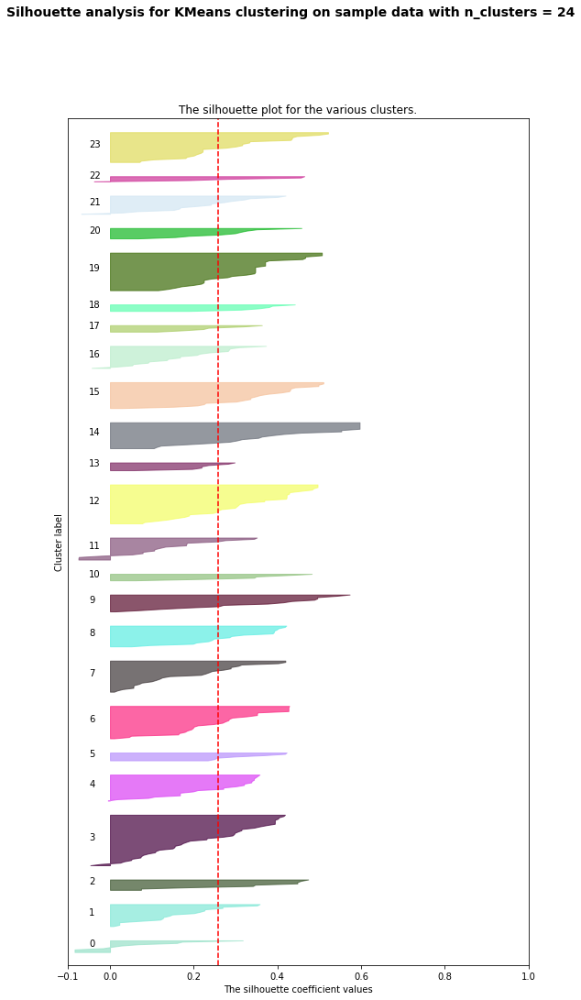

For n_clusters = 32 The average silhouette_score is : 0.24391266942172352


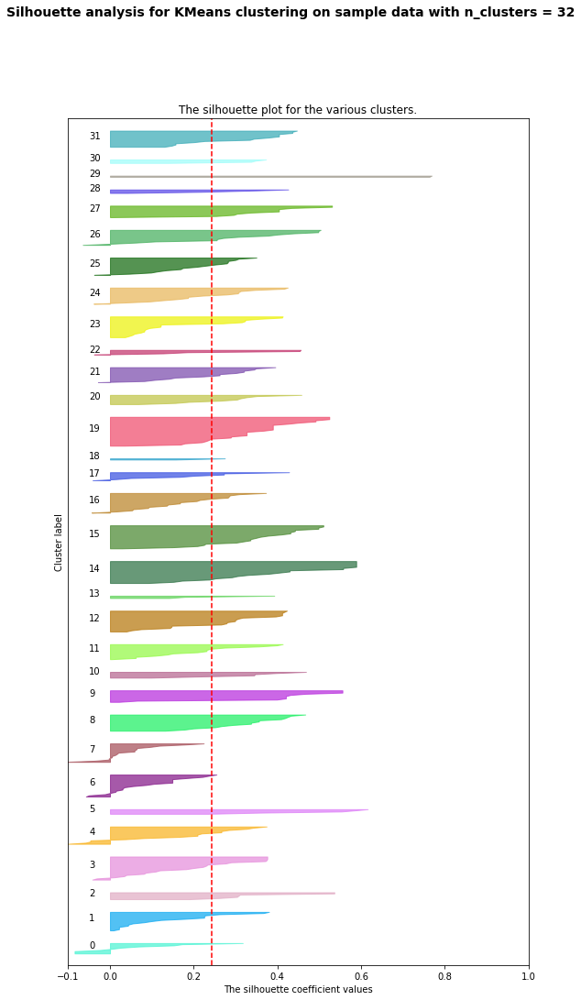

For n_clusters = 36 The average silhouette_score is : 0.2532397245171462


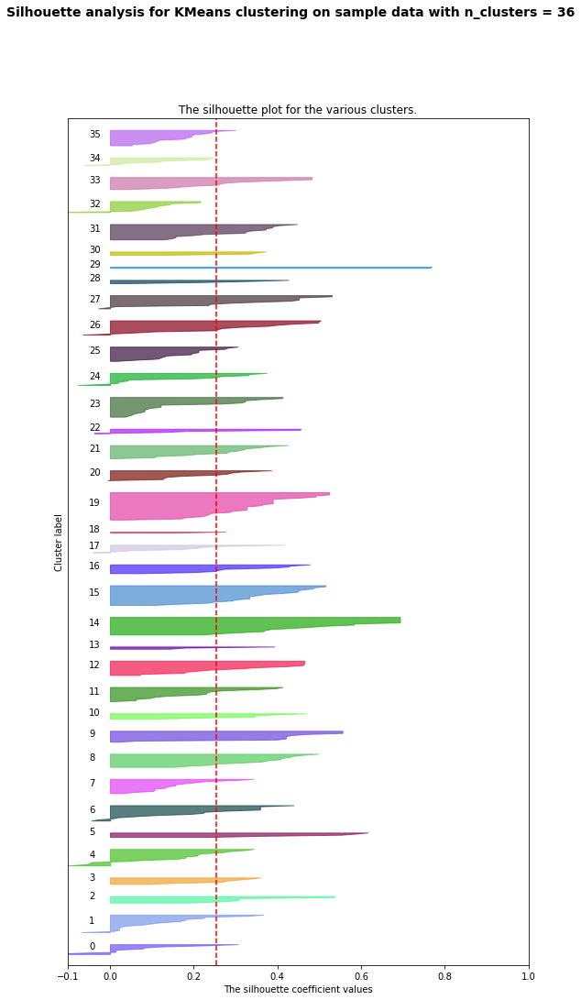

For n_clusters = 42 The average silhouette_score is : 0.271150358197174


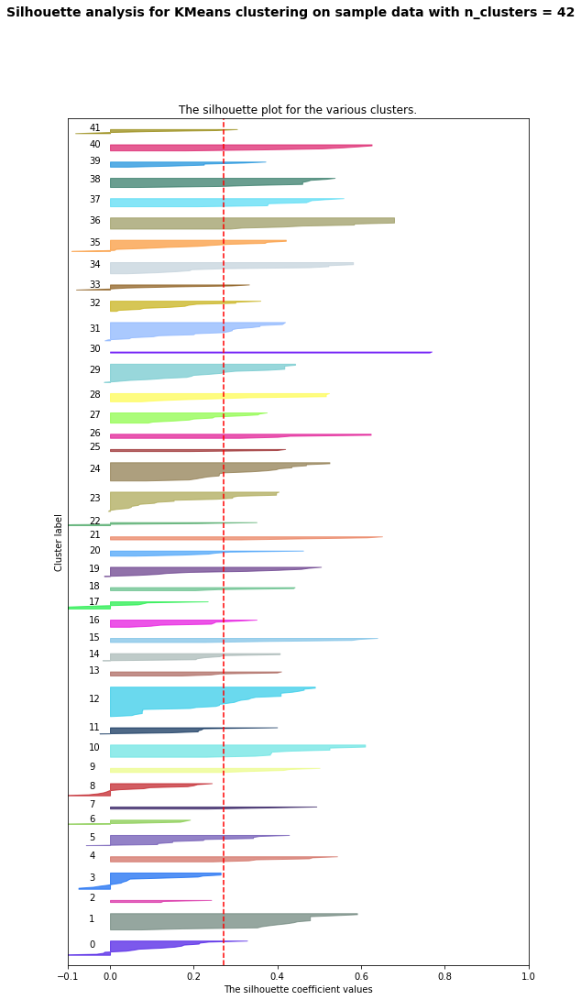

In [83]:
# modified from: http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
import random

for n_clusters in range_n_clusters:
    # Create a subplot
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(9, 17)

    # The silhouette coefficient can range from -1, 1 but in this example all lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        # select a random color for this cluster
        r = lambda: random.randint(0,255)
        color = '#%02X%02X%02X' % (r(),r(),r())
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

    plt.show()

In [84]:
# set the number of clusters in the final model
my_n_clusters = 26

In [85]:
km = KMeans(n_clusters=my_n_clusters, max_iter=1200)
km.fit(X)

KMeans(max_iter=1200, n_clusters=26)

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 0
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


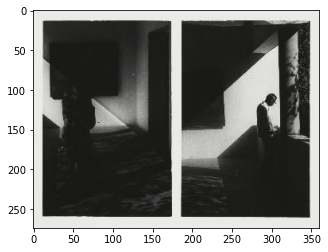

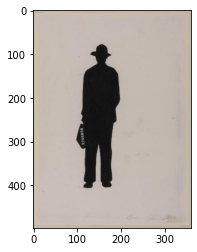

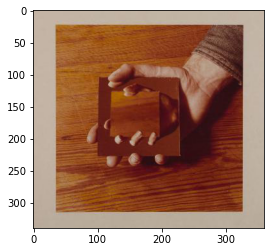

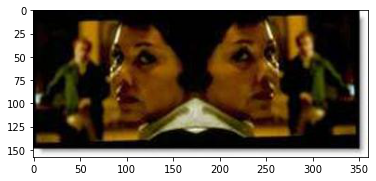

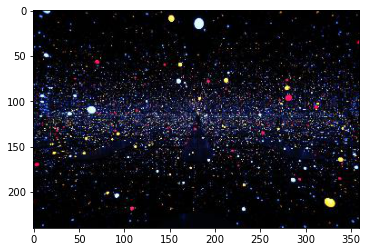

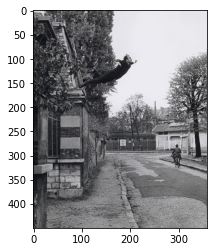

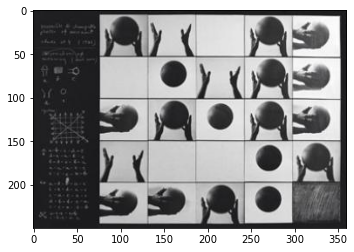

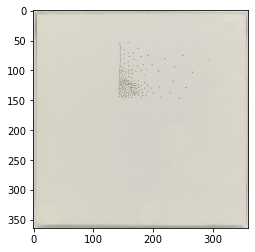

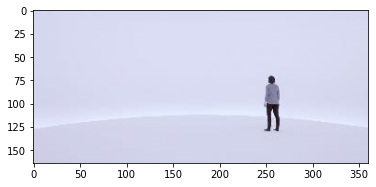

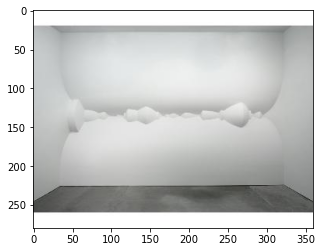

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 1
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


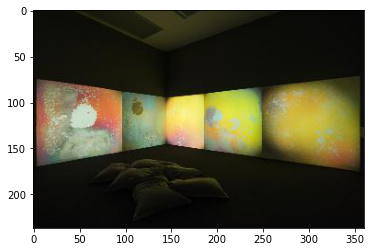

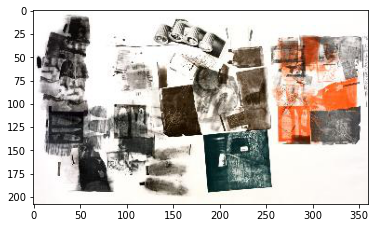

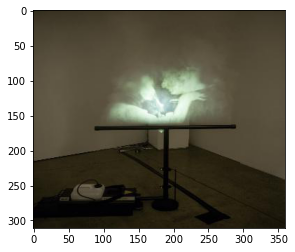

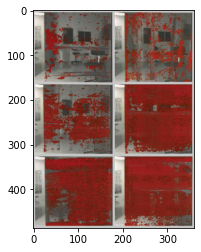

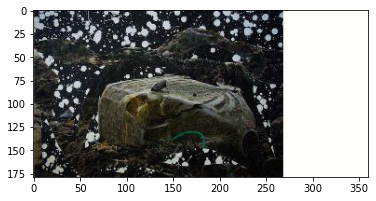

...

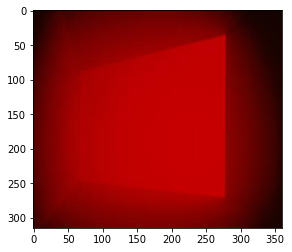

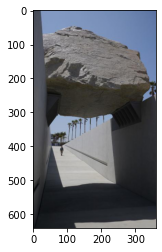

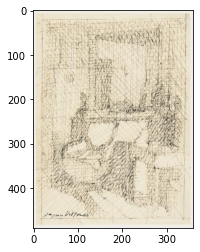

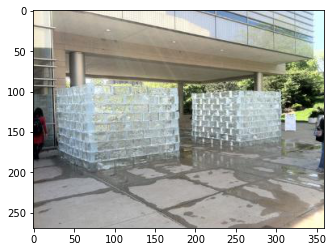

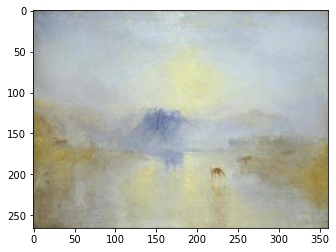

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 2
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


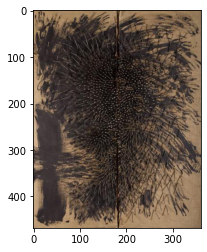

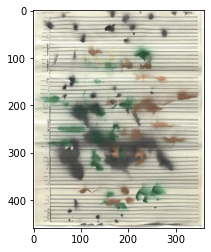

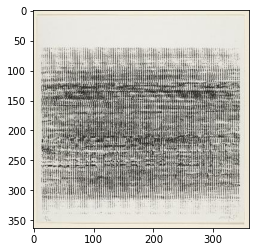

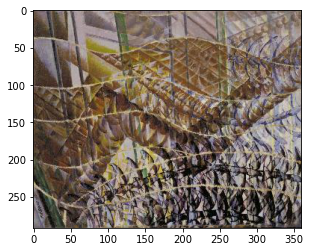

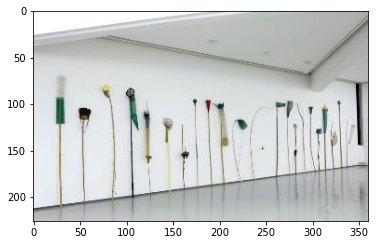

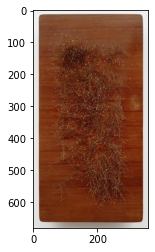

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 3
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


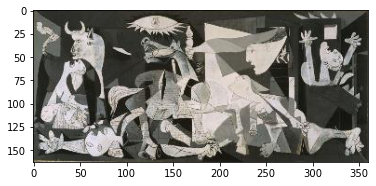

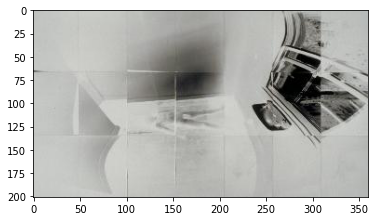

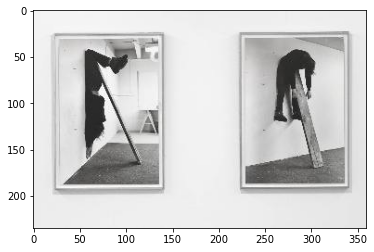

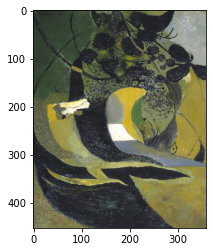

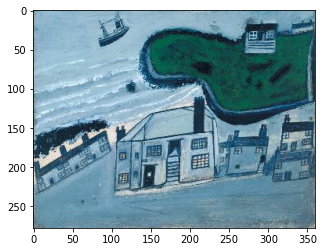

...

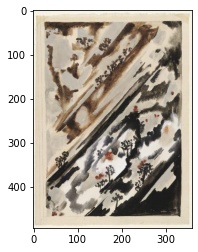

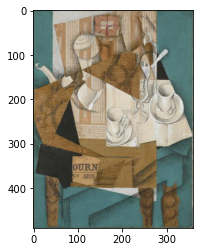

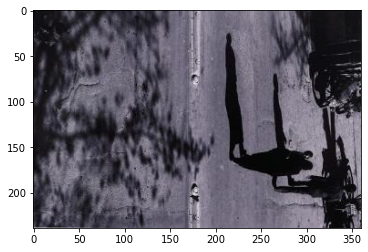

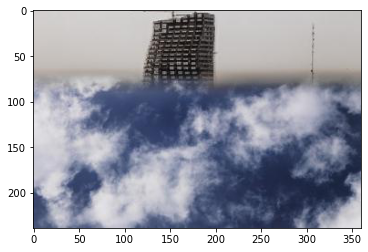

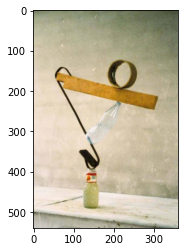

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 4
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


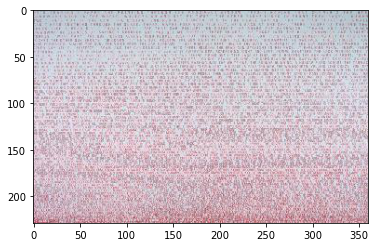

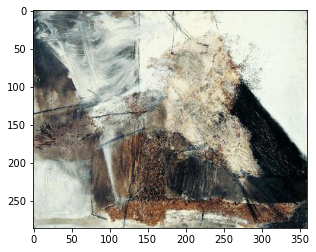

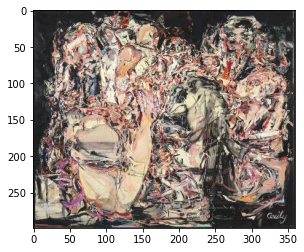

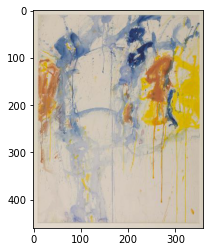

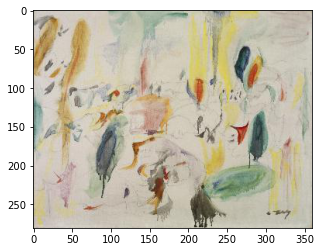

...

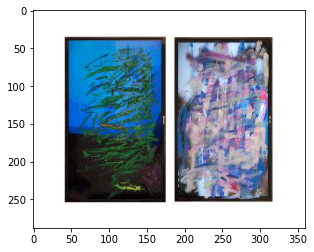

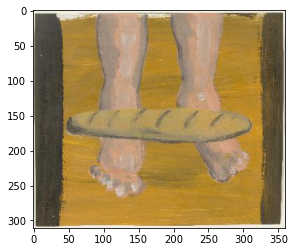

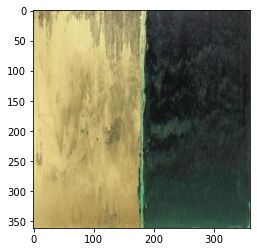

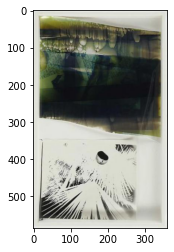

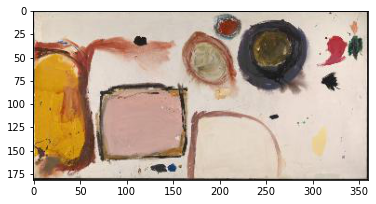

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 5
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


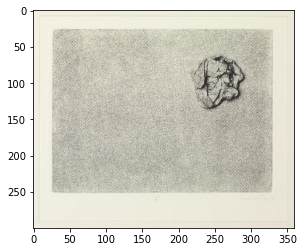

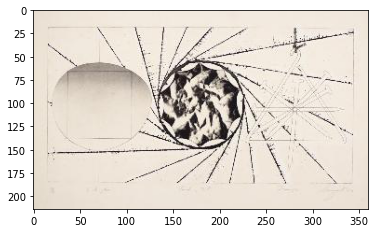

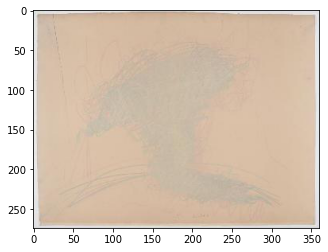

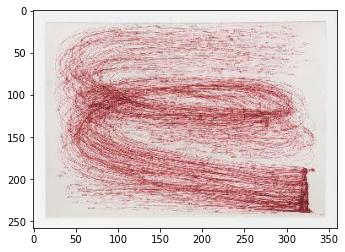

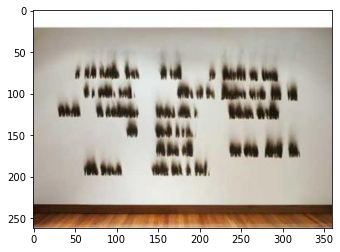

...

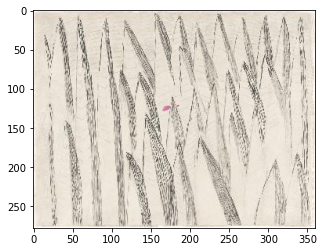

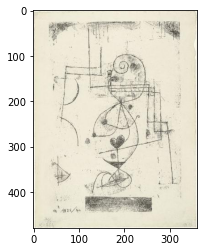

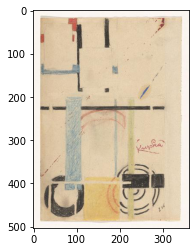

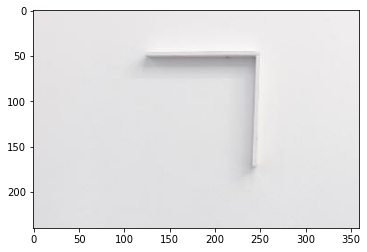

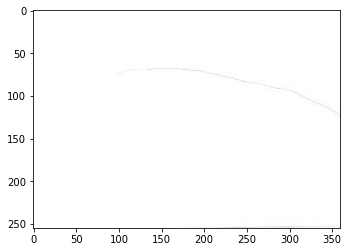

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 6
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


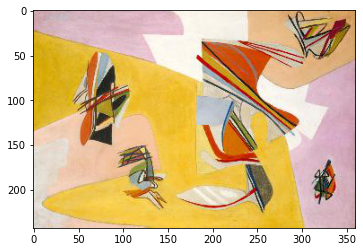

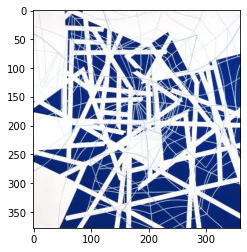

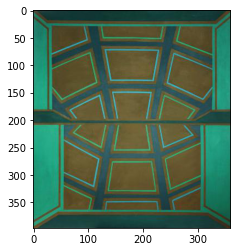

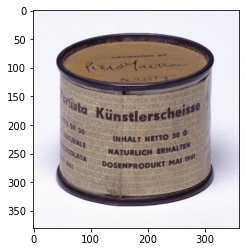

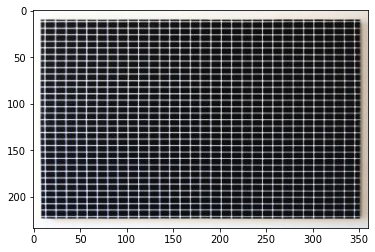

...

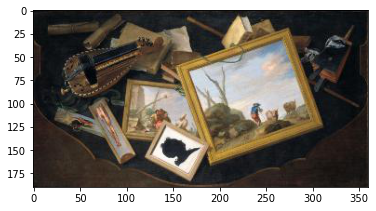

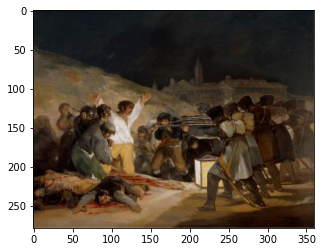

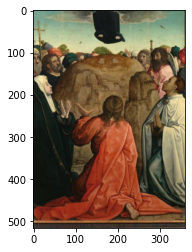

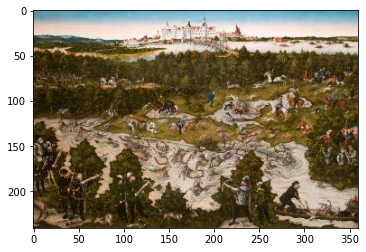

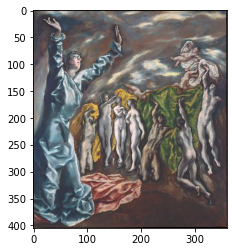

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 7
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


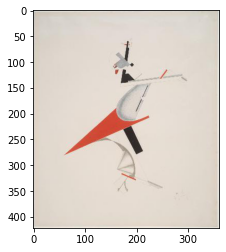

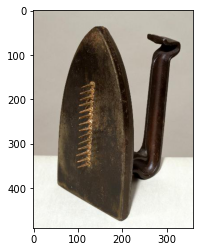

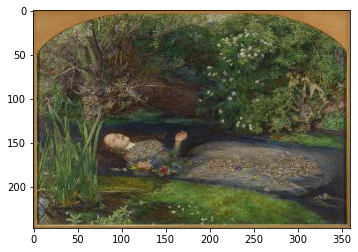

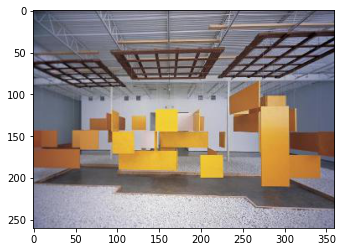

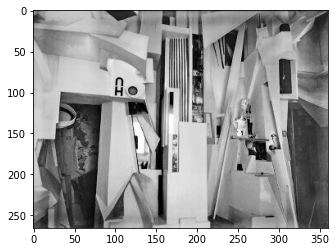

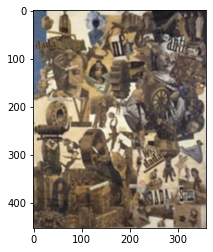

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 8
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


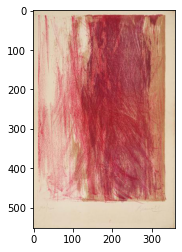

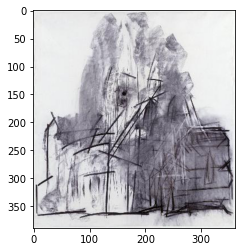

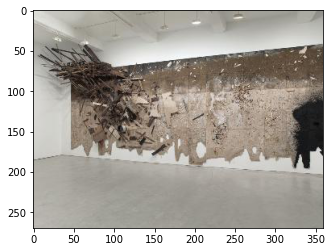

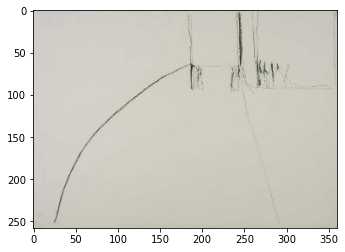

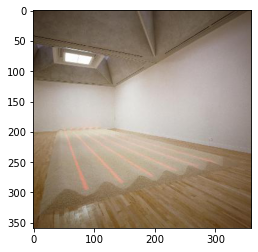

...

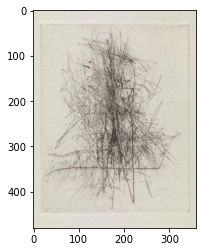

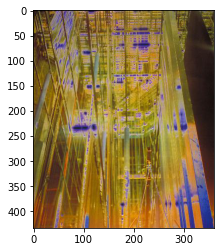

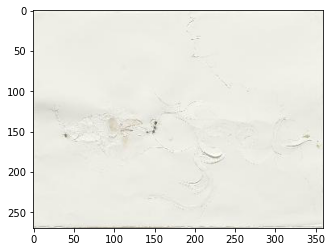

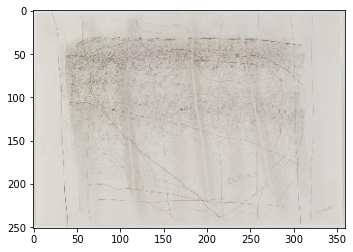

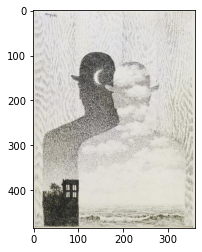

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 9
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


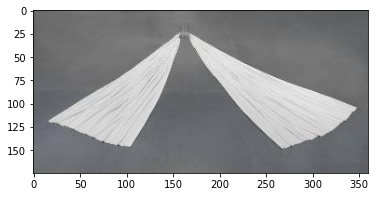

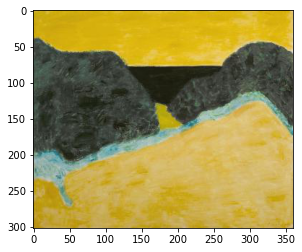

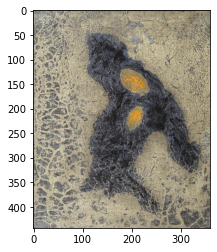

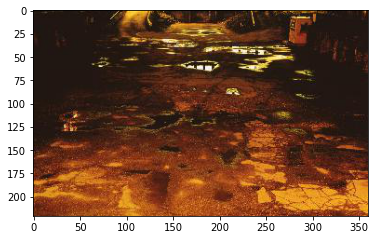

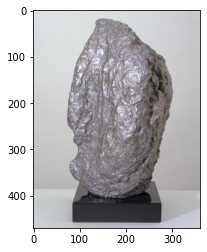

...

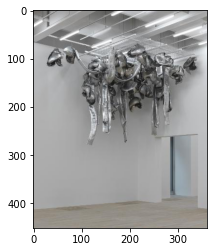

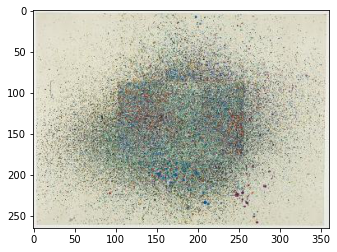

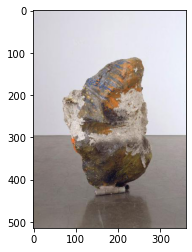

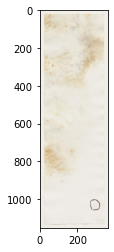

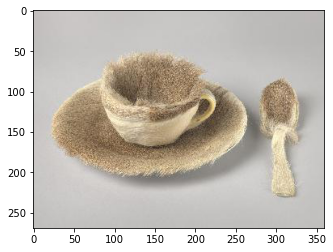

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 10
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


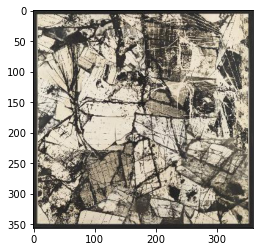

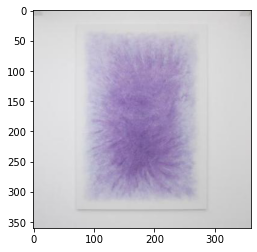

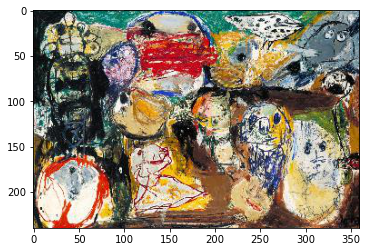

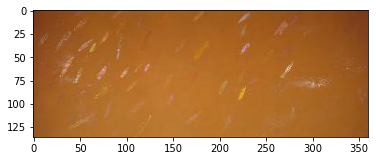

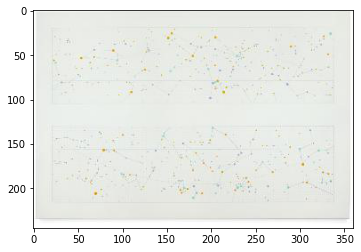

...

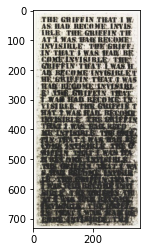

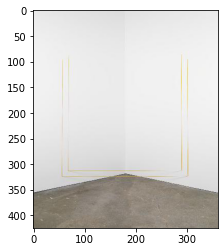

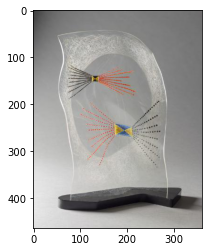

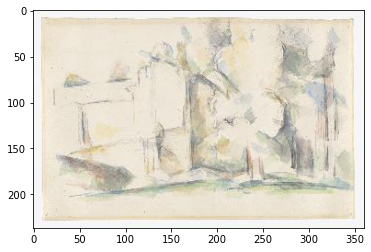

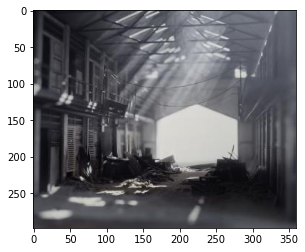

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 11
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


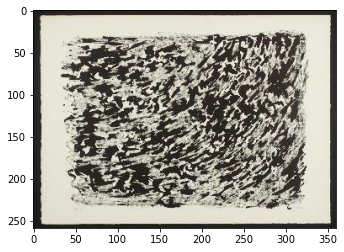

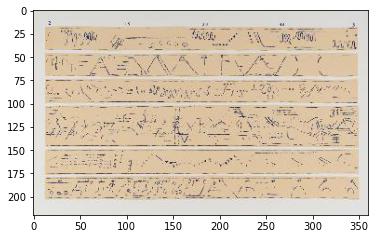

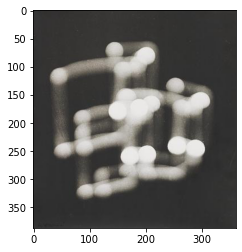

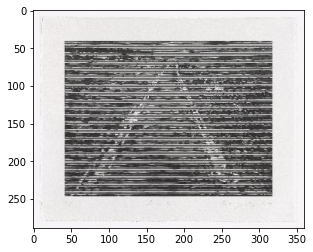

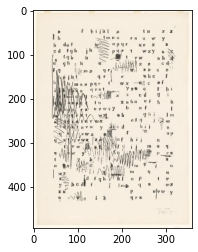

...

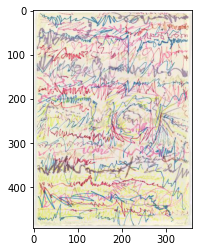

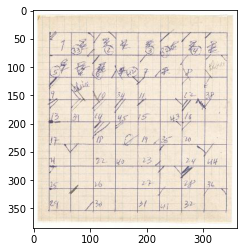

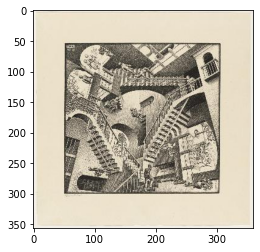

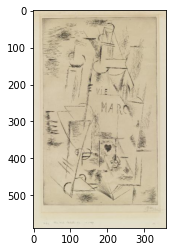

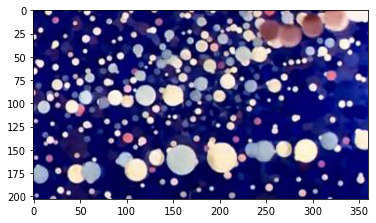

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 12
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


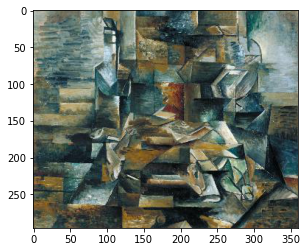

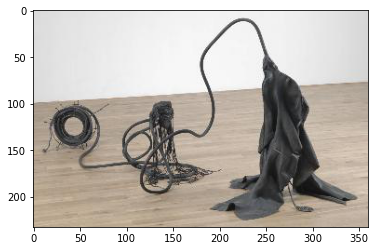

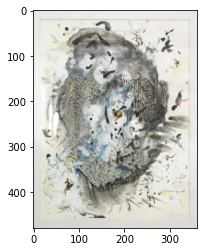

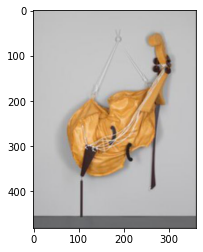

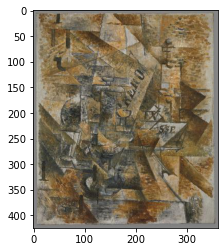

...

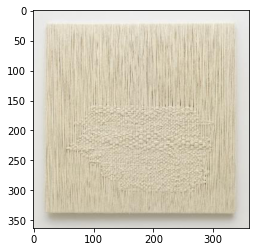

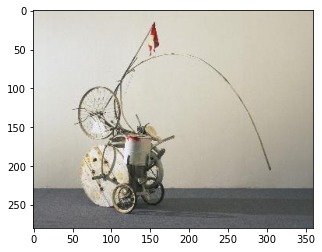

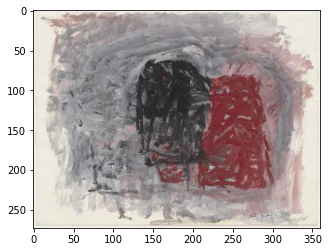

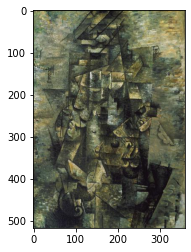

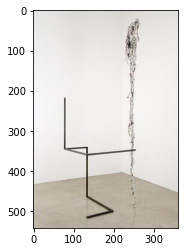

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 13
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


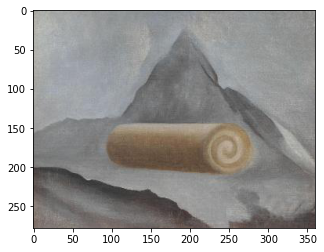

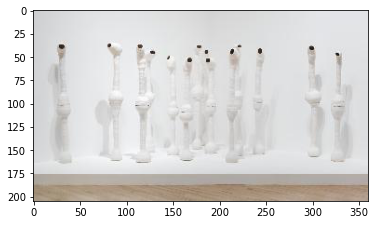

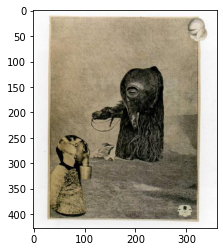

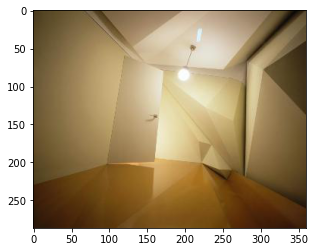

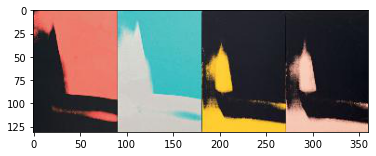

...

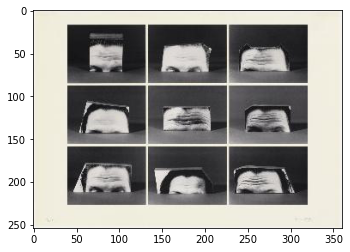

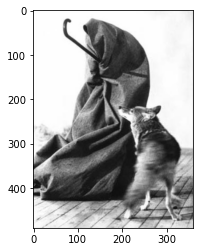

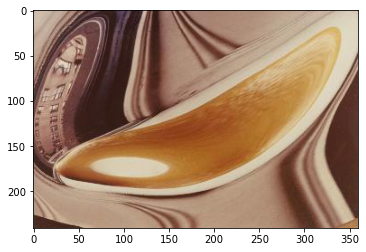

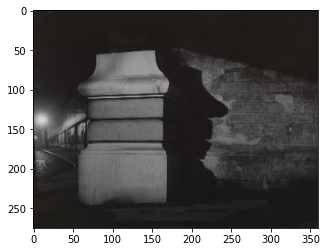

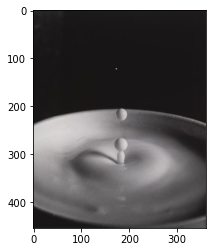

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 14
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


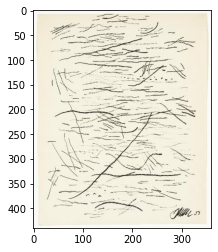

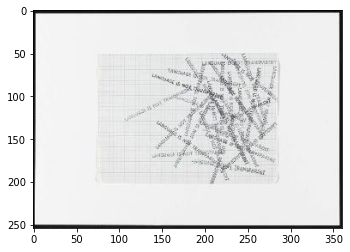

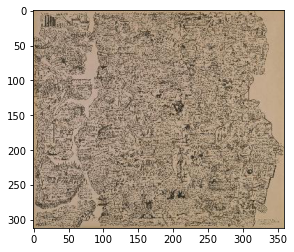

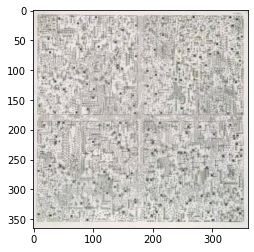

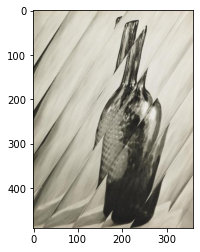

...

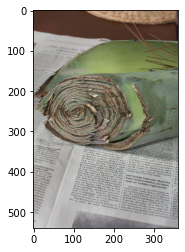

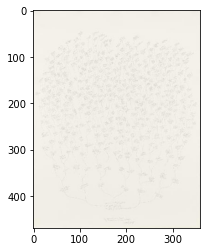

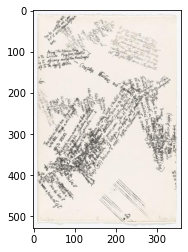

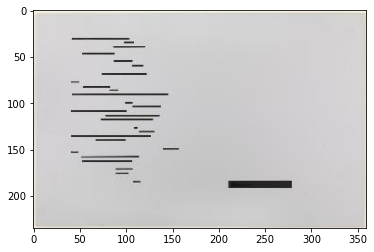

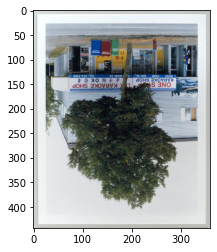

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 15
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


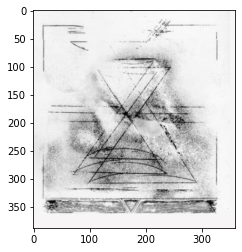

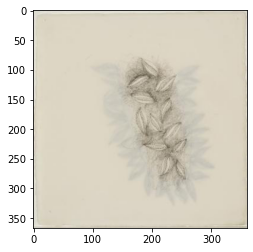

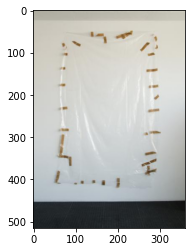

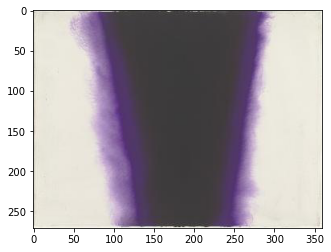

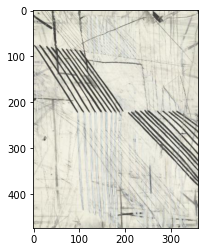

...

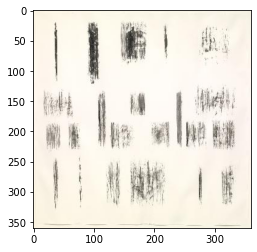

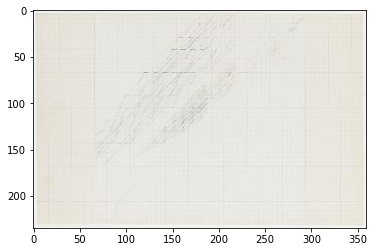

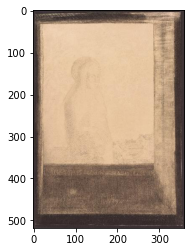

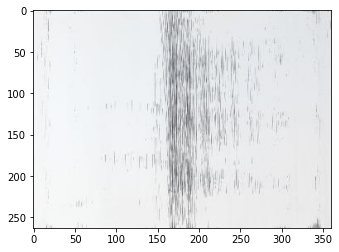

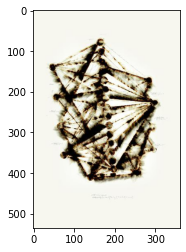

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 16
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


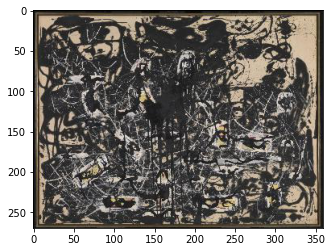

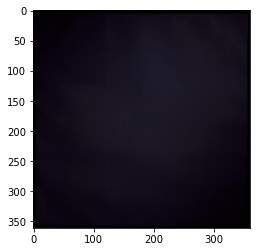

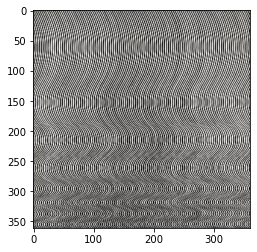

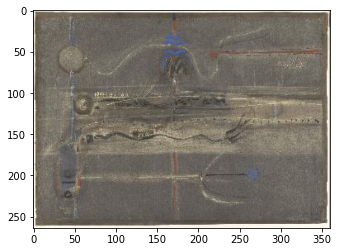

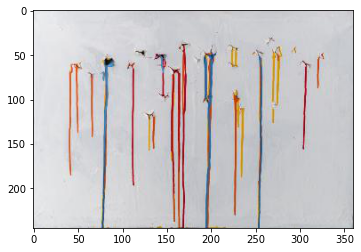

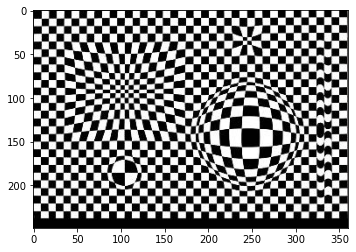

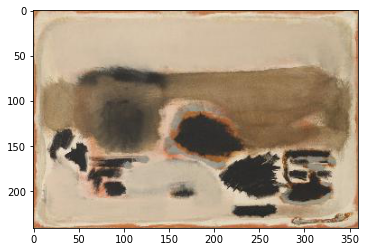

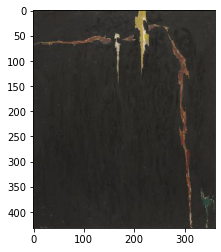

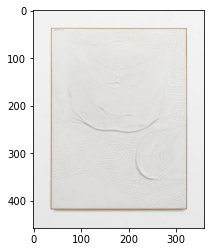

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 17
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


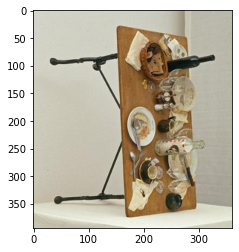

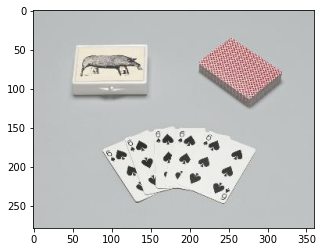

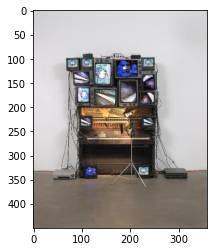

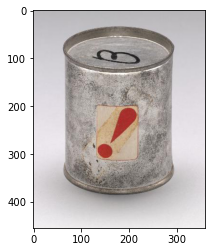

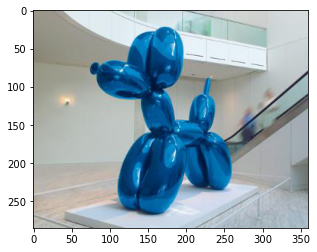

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 18
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


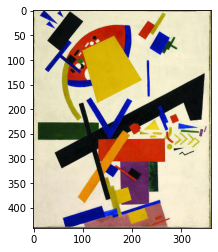

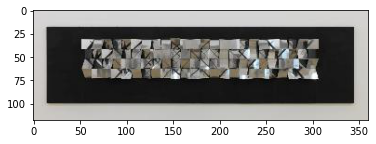

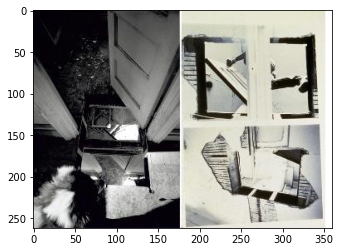

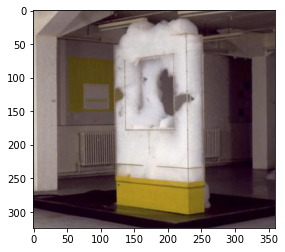

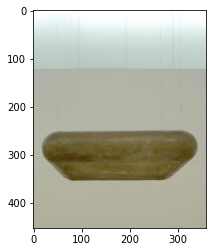

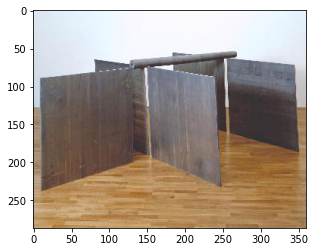

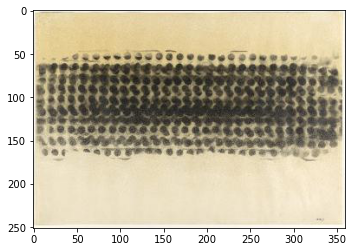

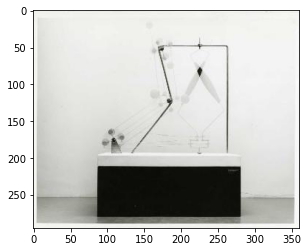

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 19
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


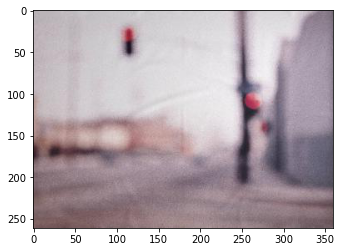

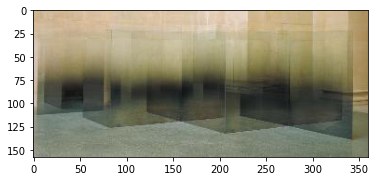

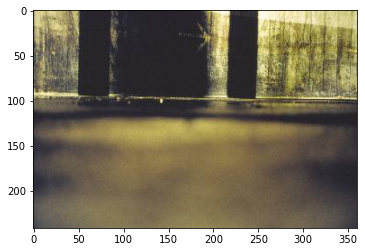

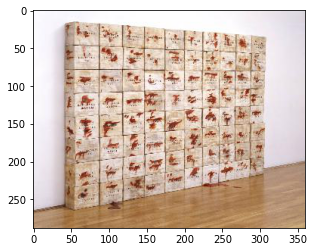

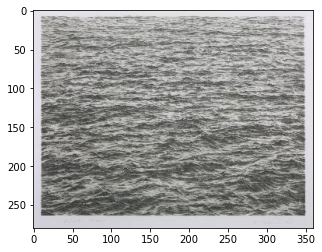

...

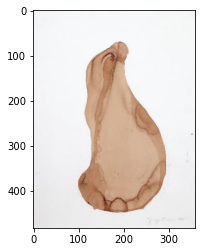

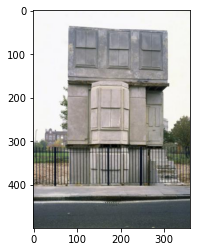

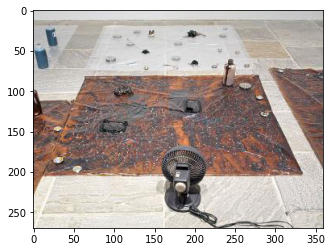

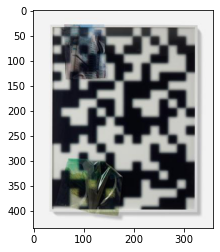

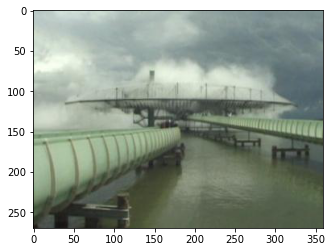

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 20
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


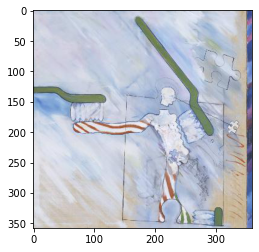

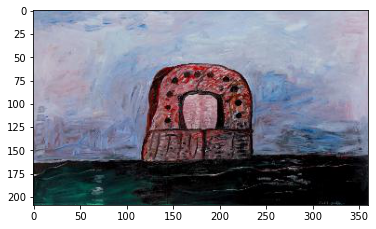

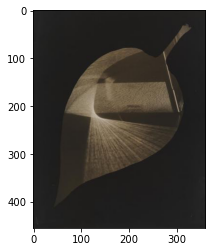

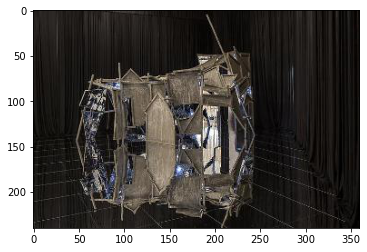

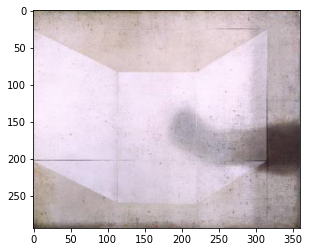

...

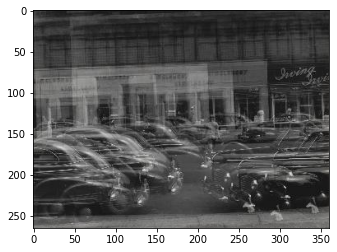

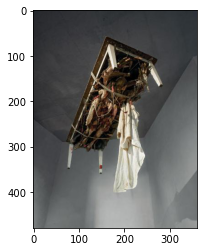

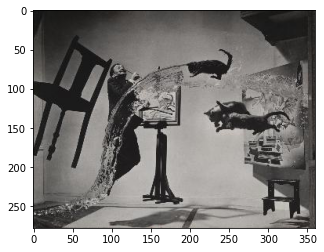

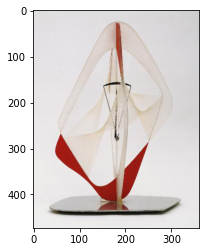

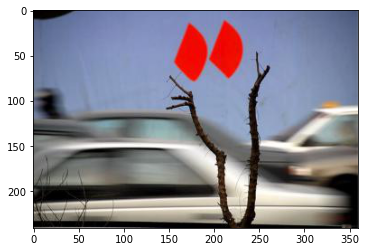

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 21
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


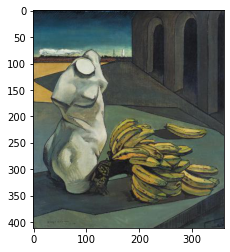

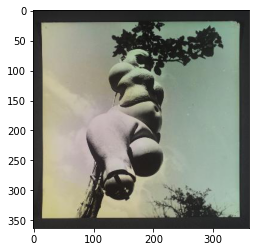

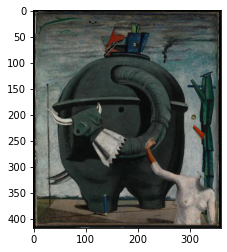

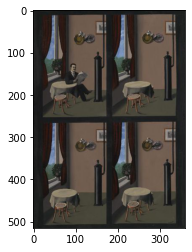

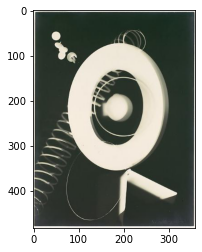

...

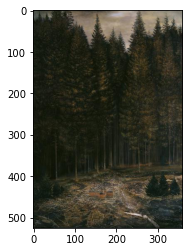

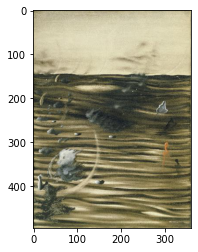

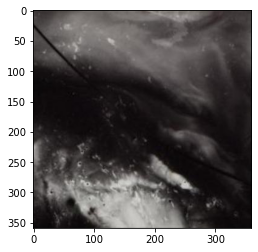

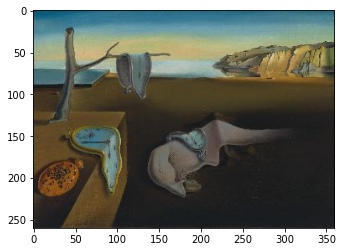

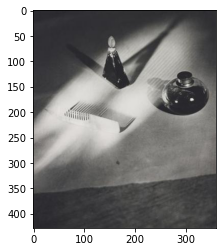

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 22
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


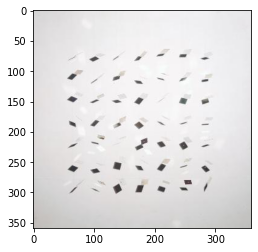

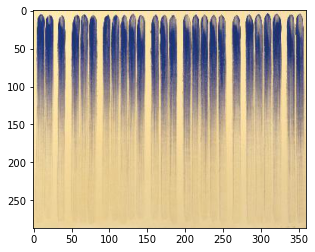

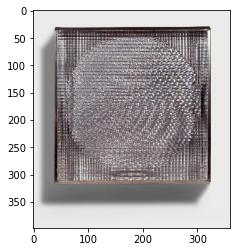

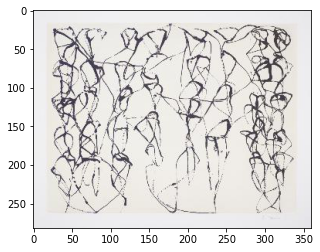

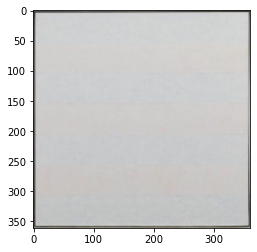

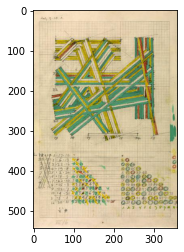

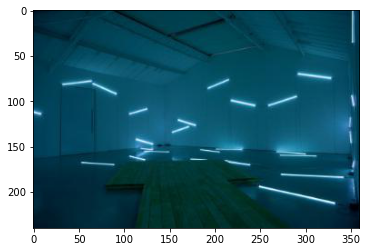

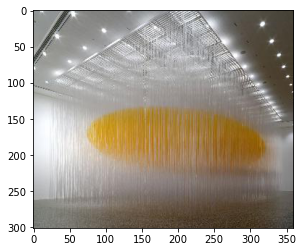

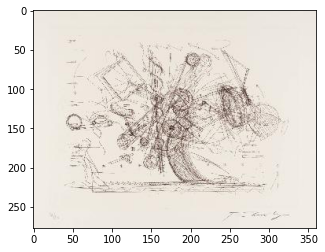

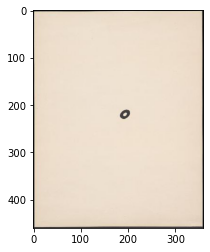

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 23
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


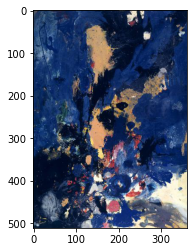

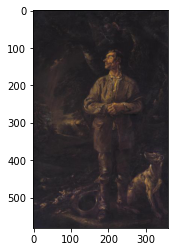

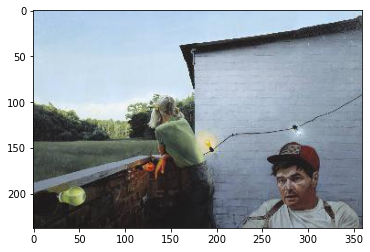

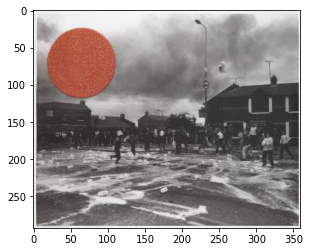

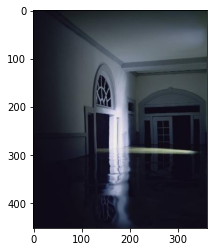

...

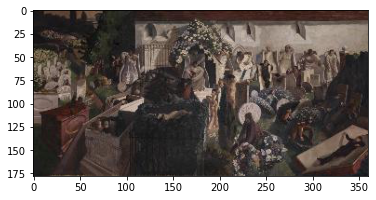

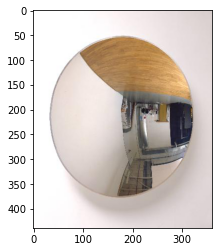

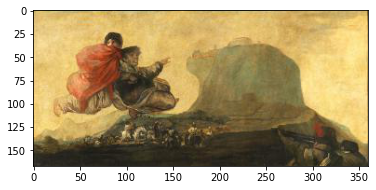

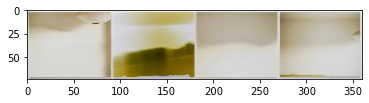

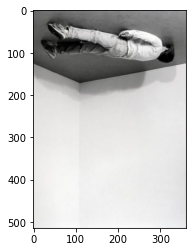

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 24
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


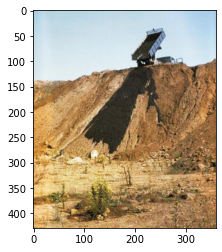

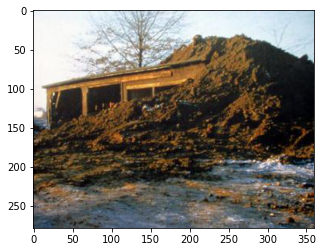

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 25
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


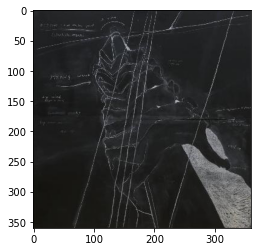

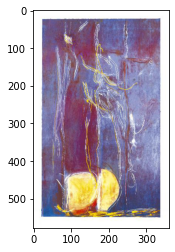

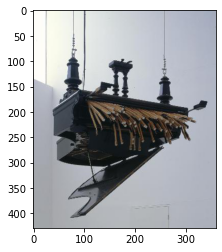

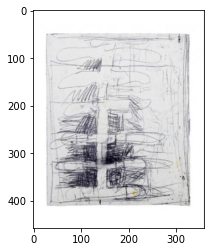

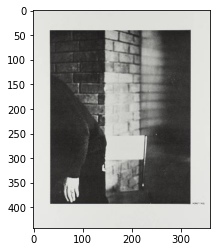

...

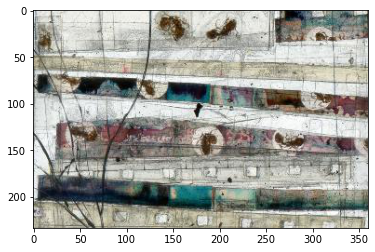

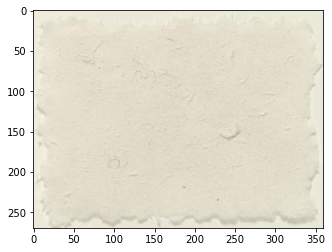

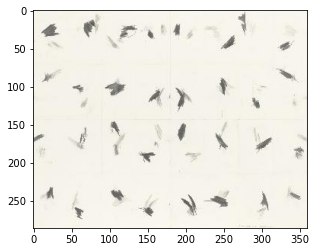

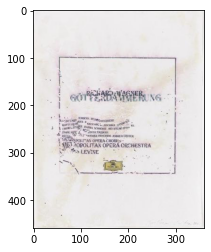

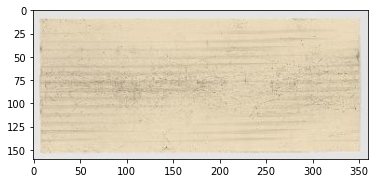

In [86]:
for i in range(0, max(km.labels_)+1):
    print(" ")
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    print("Images in cluster: " + str(i))
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    for j in range(0, len(km.labels_)):
        if km.labels_[j] == i:
            img = mpimg.imread('img_small/' +str(j+2) + '_small.jpg')
            imgplot = plt.imshow(img)
            plt.show()
#             print(str(j+2) + '_small.jpg')